[< GitHub Repo](https://github.com/PeterEFrancis/graphPlot)


[graphPlot Docs Home](index.html)
## Complex Examples
   - [The Robe Bridge](complex-examples.html#The-Rope-Bridge)
   - [The Grid](complex-examples.html#The-Grid)
   - [A Large Bipartite Graph](complex-examples.html#A-Large-Bipartite-Graph)
____

In [1]:
from graphPlot import *
import random as rand

### The Rope Bridge

In this example, we attempt to generate a figure similar to what one might (slopily) construct as a rope bridge. We will make several layers of nodes each connecting to the next in an interesting way: a node can connect to the next layer if it is only 1 node away from teh directly adjacent one, and will only do so with probablility $.5$. We will then fix the first and last layers.

In [3]:
numLayers = 10
numPerLayer = 10
prob = .5
radius = 1

layers = [[numPerLayer * l + n + 1 for n in range(numPerLayer)] for l in range(numLayers)]

aDict = {}

for i in range(numLayers - 1):
    for ID in layers[i]:
        connections = []
        for possConn in layers[i + 1]:
            if rand.random() < prob and abs(possConn - (ID + numPerLayer)) <= radius:
                connections += [possConn]
        aDict[ID] = list(set(connections + [ID + numPerLayer]))

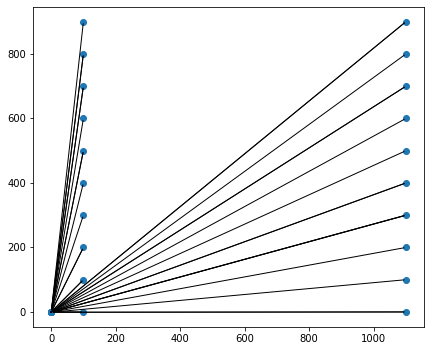

In [4]:
web = SpringBoard(aDict, k = 75, Q = -1)
for i in range(numPerLayer):
    web.set_node_pos(i + 1, (100, 100 * i))
    web.set_node_pos(numLayers * numPerLayer - i, (100 * (1 + numLayers), 100 * (numPerLayer - i - 1)))
web.fix_nodes(list(range(1, numPerLayer + 1)))
web.fix_nodes(list(range((numLayers - 1) * numPerLayer + 1, numLayers * numPerLayer + 1)))
web.plot()

In [5]:
web.move(0.1, 100)

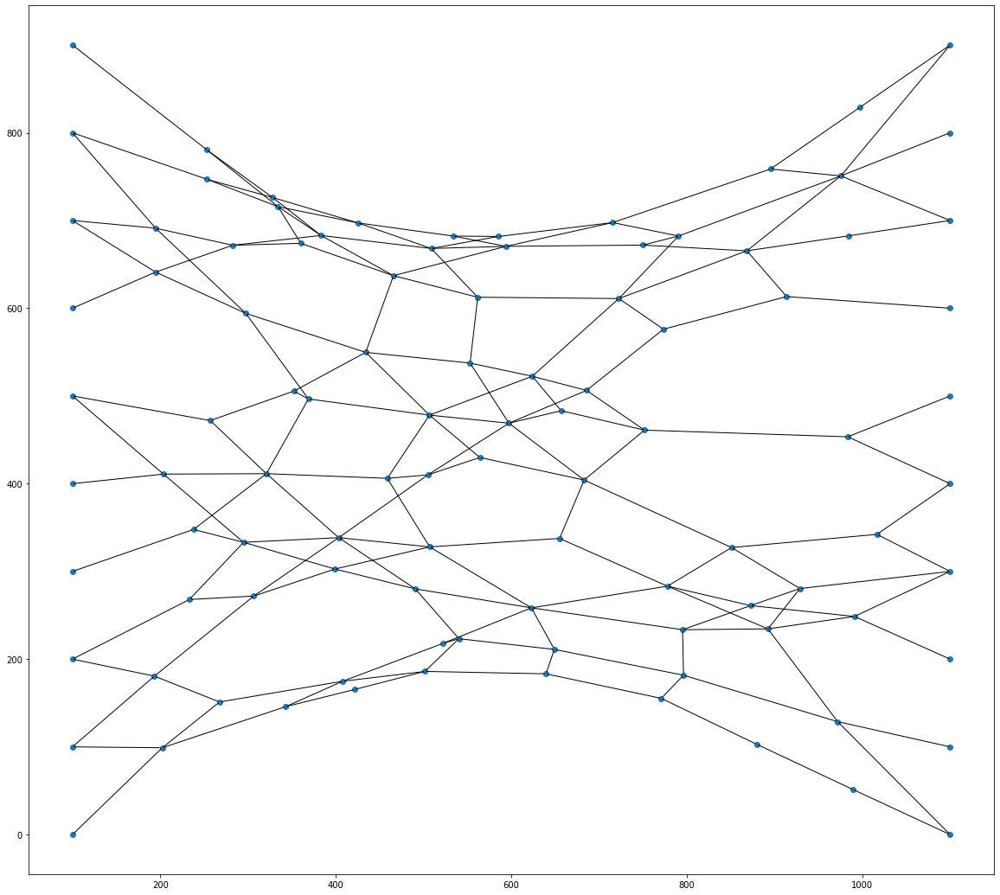

In [28]:
web.plot((20,20))

### The Grid

We will construct a grid of nodes and fix the outer layer. Then we will displace a center one and observe how the other nodes pull it back into place.

In [12]:
adjacencyDict = {}
posDict = {}
toFix = []
l = 10

for r in range(l):
    for c in range(l):
        el = l * r + c + 1
        posDict[el] = (6 * r + 10, 6 * c + 10) if r == c and r == 5 else (6 * r, 6 * c)
        adjacencyDict[el] = []
        if r != l - 1:
            adjacencyDict[el] += [el + l]
        if c != l - 1:
            adjacencyDict[el] += [el + 1]
        if (c == l - 1) or (c == 0) or (r == 0) or (r == l - 1):
            toFix += [el]

In [13]:
G = SpringBoard(adjacencyDict, k=1, Q=-1, nodePosDict=posDict)
G.fix_nodes(toFix)

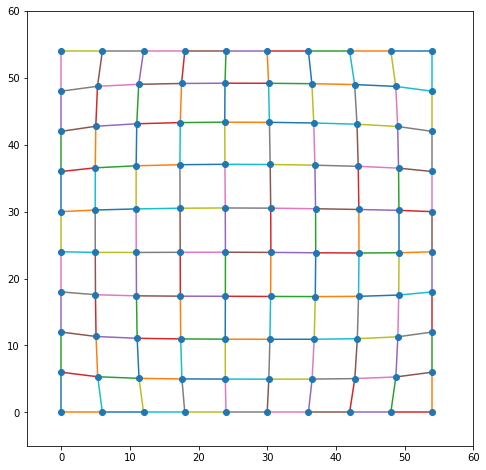

In [14]:
ani = G.animate(deltaT = 0.1, numFrames = 80, movesPerFrame = 25, xlim = [-5,60], ylim = [-5,60], size = (8,8))

from IPython.display import HTML
HTML(ani.to_jshtml())

### A Large Bipartite Graph

A bipartit graph has two subset of nodes with the property that any node in one subset is not connected to any other node in its own subset, but is connected to every node in the other.

In [10]:
num = 10

aDict = {}
for ID in range(1, num + 1):
    aDict[ID] = list(range(num + 1, num * 2 + 1))
for ID in range(num + 1, 2 * num + 1):
    aDict[ID] = list(range(1, num + 1))
    
posDict = {}
for ID in range(1, num + 1):
    posDict[ID] = (rand.random() * 2 - 10, rand.random() * 20 - 10) # distributed in x = (-10, 8) and y = (-10,10)
for ID in range(num + 1, 2 * num + 1):
    posDict[ID] = (8 + rand.random() * 2, rand.random() * 20 - 10) # distributed in x = (8, 10) and y = (-10,10)

LBG = SpringBoard(aDict, 1, -1, posDict)

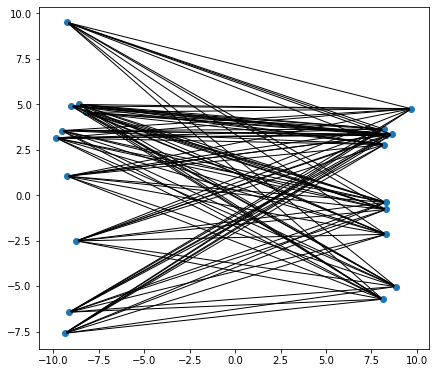

In [11]:
LBG.plot()

Animation size has reached 21084777 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


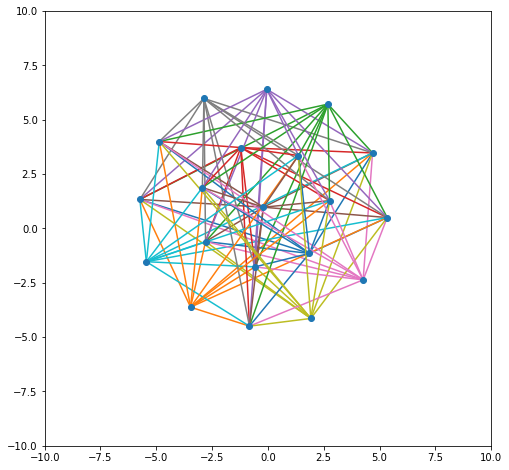

In [12]:
ani = LBG.animate(deltaT = 0.1, numFrames = 150, movesPerFrame = 50, xlim = [-10,10], ylim = [-10,10], size = (8,8))

from IPython.display import HTML
HTML(ani.to_jshtml())